## Домашнее задание №4
### Deadline - 14 November 23:59

Данное задание посвящено семантической сегментации. Ваша цель реализовать модель сегментации cпутниковых снимков на датасете [FloodNet Challenge](http://www.classic.grss-ieee.org/earthvision2021/challenge.html).. В первой части задания вы реализуете основные инструменты, которые необходимы для задачи сегментации: подсчет метрик, архитектуры, логгирование метрик. Во второй части вам предложено улучшить текущее решение и выбить заданные скор на задаче, используя любые трюки/идеи, которые вы сможете реализовать

## Часть 1: Базовое решение (1/3 от максимального числа баллов)
- Подсчет метрик
- Архитектуру модели (реализовать UNet)
- Обучение модели

### Loading dataset

In [1]:
!gdown --id 1vLTGoRO1zeQSZ0mfRTgVC9W6R5Z94UoO

/home/srv-user3/.conda/envs/jupyter-aid/lib/python3.10/site-packages/gdown/cli.py:126: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (uriginal): https://drive.google.com/uc?id=1vLTGoRO1zeQSZ0mfRTgVC9W6R5Z94UoO
From (redirected): https://drive.google.com/uc?id=1vLTGoRO1zeQSZ0mfRTgVC9W6R5Z94UoO&confirm=t&uuid=5cc0a55d-b490-49d7-b2ca-13a1dcbccf5d
To: /media/jupyter/3/university/deeplearning/tiny-floodnet-challenge.tar.gz
100%|██████████████████████████████████████| 50.4M/50.4M [00:02<00:00, 17.2MB/s]


Распаковываем архив

In [2]:
!tar -xzf tiny-floodnet-challenge.tar.gz

In [ ]:
import tqdm
import torch
import torch.nn as nn
import torch.nn.functional as F

from matplotlib import pyplot as plt
from torch.utils.data import Dataset, DataLoader
from torch.utils.tensorboard import SummaryWriter
from torchvision.transforms import ToTensor, PILToTensor, Compose

### Dataset

Датасет уже содержит разбиение на обучающую и тестовые выборки

In [ ]:
import glob
import os
import numpy as np
import albumentations as A

from PIL import Image

Для обработки изображений будем использовать библиотеку [albumentations](https://albumentations.ai/docs/). В ней содержиться больше аугментаций чем в torchvision, а также реализовано более удобная работа с аугментациями.

In [ ]:
!pip install albumentations -q

Реализуйте загрузку данных

In [ ]:
from monai.transforms import Compose, DivisiblePadd, AddChannelD, CenterSpatialCropd
class FloodNet(Dataset):
    """
    Классы:
    0: Background, 1: Building, 2: Road, 3: Water, 4: Tree, 5: Vehicle, 6: Pool, 7: Grass
    """
    def __init__(
        self,
        data_path: str,
        phase: str,
        augment: bool,
        img_size: int,
    ):
        self.num_classes = 8
        self.data_path = data_path
        self.phase = phase
        self.augment = augment
        self.img_size = img_size

        self.items = [filename.split('.')[0] for filename in os.listdir(f'{data_path}/{phase}/image')]

        if phase == 'train':
            self.transform = Compose([AddChannelD(keys=['mask']),
                                      DivisiblePadd(keys=['image', 'mask'], k=16, method='symmetric', mode='constant'),
                                      CenterSpatialCropd(keys=['image', 'mask'], roi_size=[752, 1008])])    
        else:
            self.transform = Compose([AddChannelD(keys=['mask']),
                                      DivisiblePadd(keys=['image', 'mask'], k=16, method='symmetric', mode='constant')])    

        self.to_tensor = ToTensor()

    def __len__(self):
        return len(self.items)

    def __getitem__(self, index):
        image = np.asarray(Image.open(f'{self.data_path}/{self.phase}/image/{self.items[index]}.jpg'))
        mask = np.asarray(Image.open(f'{self.data_path}/{self.phase}/mask/{self.items[index]}.png'))

        image = self.to_tensor(image.copy())
        mask = torch.from_numpy(mask.copy()).long()


        tmp = self.transform({'image':image, 'mask': mask})
        return tmp['image'], tmp['mask'][0]

In [ ]:
NUM_CLASSES=8

In [ ]:
train_dataset = FloodNet(data_path='tiny-floodnet-challenge',
                         phase='train', 
                         augment=True, 
                         img_size=256)

test_dataset = FloodNet(data_path='tiny-floodnet-challenge', 
                        phase='test', 
                        augment=True, 
                        img_size=256)

Берем небольшой батч, так как иначе изображения не поместятся в память

In [ ]:
train_dataloader = DataLoader(train_dataset, num_workers=1, batch_size=1, shuffle=True)

val_dataloader = DataLoader(test_dataset, num_workers=1, batch_size=1, shuffle=False)

In [ ]:
for x, y in train_dataloader:
    print(x.shape, y.shape)
    break
for x, y in val_dataloader:
    print(x.shape, y.shape)
    break

### Metrics

Мы закончили с реализацией датасета. Теперь необходимо реализовать подсчет IoU, Recall, Accuracy

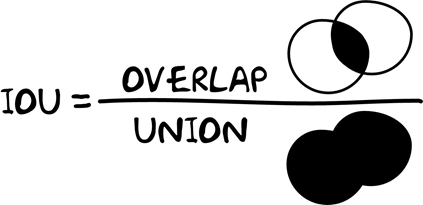

In [ ]:
def iou(net_output, target, class_label=torch.tensor(1).type(torch.int), eps=1e-6):
    net_out_ = (net_output == class_label)
    target_ = (target == class_label)
    return (torch.sum(net_out_ * target_))/(torch.sum(torch.maximum(net_out_, target_)) + eps)

def recall(net_output, target, class_label=torch.tensor(1).type(torch.int), eps=1e-6):
    net_out_ = (net_output == class_label)
    target_ = (target == class_label)
    return (torch.sum(net_out_ * target_))/(torch.sum(target_) + eps)

def accuracy(net_output, target, class_label=torch.tensor(1).type(torch.int), eps=1e-6):
    net_out_ = (net_output == class_label)
    target_ = (target == class_label)
    return (torch.sum(net_out_ == target_))/(torch.sum(torch.ones_like(target_)) + eps)

def calc_val_data(outputs, masks, num_classes):
    softmax     = torch.nn.Softmax(dim=1)
    probability = softmax(outputs)
    prediction  = torch.argmax(probability, dim=1)
    mean_iou, mean_recall, mean_acc = [], [], []

    for i in range(outputs.shape[1]):
        mean_iou.append(iou(prediction, masks, i).item())
        mean_recall.append(recall(prediction, masks, i).item())
        mean_acc.append(accuracy(prediction, masks, i).item())
    return np.mean(mean_iou), np.mean(mean_recall), np.mean(mean_acc)

### Model

В качестве базовой модели будем использовать UNet. Архитектура представлена ниже. Вам не нужно точно воспроизвести архитектуру. Важно реализовать передачу intermediate features, полученные от encoder к decoder.

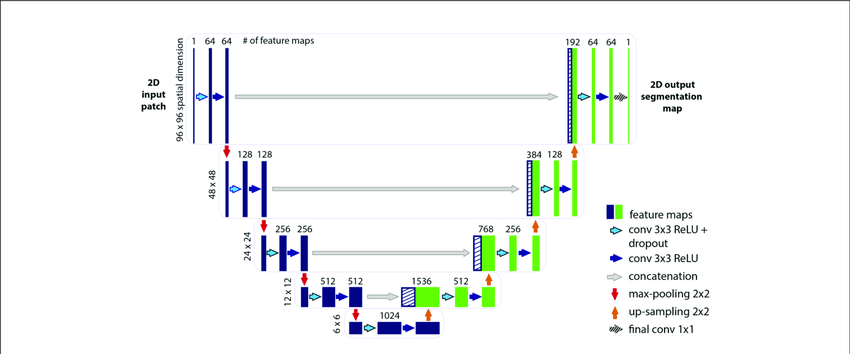

In [ ]:
import torch
from torch import nn
from torch.nn import functional as F
from torchvision import models

class DownBlock(nn.Module):
    def __init__(self, in_channel, out_channel, kernel_size=3, stride=1, down=True):
        super().__init__()
        self.conv1   = nn.Conv2d(in_channels=in_channel, 
                                 out_channels=out_channel, 
                                 kernel_size=kernel_size, 
                                 stride=stride,
                                 padding=1,
                                 bias=True)
        self.conv2  = nn.Conv2d(in_channels=out_channel, 
                                 out_channels=out_channel, 
                                 kernel_size=kernel_size, 
                                 stride=stride, 
                                 padding=1,
                                 bias=True)
        self.norm    = nn.BatchNorm2d(num_features=out_channel)
        self.maxpool = nn.MaxPool2d(kernel_size=2)
        self.dropout = nn.Dropout(p=0)
        self.prelu   = nn.PReLU()

    def forward(self, x):
        x = self.conv1(x)
        x = self.norm(x)
        x = self.dropout(x)
        x = self.prelu(x)
        x = self.conv2(x)
        x = self.prelu(x)
        
        return self.maxpool(x), x

In [ ]:
class UpBlock(nn.Module):
    def __init__(self, in_channel, prev_channel, out_channel, kernel_size=3, stride=1, up=True):
        super().__init__()
        self.conv1    = nn.Conv2d(in_channels=in_channel+prev_channel, 
                                out_channels=out_channel,
                                kernel_size=kernel_size,
                                stride=stride,
                                padding=1,
                                bias=True)
        
        self.conv2    = nn.Conv2d(in_channels=out_channel, 
                                out_channels=out_channel,
                                kernel_size=kernel_size,
                                stride=stride,
                                padding=1,
                                bias=True)
        self.norm     = nn.BatchNorm2d(num_features=out_channel)
        self.upsample = nn.Upsample(scale_factor=2)
        self.dropout  = nn.Dropout(p=0)
        self.prelu    = nn.PReLU()

    def forward(self, x, res=None):
        x = self.upsample(x)
        x = torch.cat((x, res), dim=1)
        x = self.conv1(x)
        x = self.norm(x)
        x = self.prelu(x)
        x = self.dropout(x)
        x = self.conv2(x)
        x = self.prelu(x)
        return x

Теперь совместим encoder и decoder в одну архитектуру

In [ ]:
class UNet(nn.Module):
    """
    Используя UpBlock и DownBlock, реализуйте полноценную архитектуру.
    Учтите, что разрешение изображение может не делиться на 2**num_down_blocks, поэтому
    вам нужно интерполировать его до нужного разрешения

    Для уменьшения/увеличения размерности можете использовать любой удобный вам метод
    """

    def __init__(self,
                 num_classes,
                 min_channels=32,
                 max_channels=512,
                 num_down_blocks=4,
                 kernel_size=3,
                 stride=1,
                 device='CPU'):
        super(UNet, self).__init__()
        self.num_classes = num_classes
        log_min_channels = int(np.log2(min_channels))
        log_max_channels = int(np.log2(max_channels))
        depth = log_max_channels-log_min_channels+1
        ch = [3] + [int(n) for n in np.logspace(log_min_channels,log_max_channels,num=depth, base=2)]
        self.down_blocks = [DownBlock(in_channel=ch[i], out_channel=ch[i+1]).to(device) for i in range(depth-1)]
        self.up_blocks   = [UpBlock(in_channel=ch[i], prev_channel=ch[i-1], out_channel=ch[i-1]).to(device) for i in range(depth, 1, -1)]
        self.conv1 = nn.Conv2d(in_channels=max_channels//2, 
                               out_channels=max_channels,
                               kernel_size=kernel_size,
                               stride=stride,
                               padding=1, 
                               bias=True)
        self.conv2 = nn.Conv2d(in_channels=max_channels, 
                               out_channels=max_channels,
                               kernel_size=kernel_size,
                               stride=stride,
                               padding=1, 
                               bias=True)
        self.conv3 = nn.Conv2d(in_channels=min_channels, 
                               out_channels=num_classes,
                               kernel_size=1,
                               stride=stride, 
                               bias=True)
        self.norm     = nn.BatchNorm2d(num_features=max_channels)
        self.upsample = nn.Upsample(scale_factor=2)
        self.dropout  = nn.Dropout(p=0)
        self.prelu    = nn.PReLU()

    def forward(self, x):
        results = [0 for _ in range(len(self.down_blocks))]
        inputs = torch.clone(x)
        for i, block in enumerate(self.down_blocks):
            x, tmp = block(x)
            results[len(self.down_blocks) - i - 1] = tmp
        x = self.conv1(x)
        x = self.norm(x)
        x = self.prelu(x)
        x = self.dropout(x)
        x = self.conv2(x)
        x = self.prelu(x)
        for i, block in enumerate(self.up_blocks):
            x = block(x, res=results[i])
        logits = self.conv3(x)
        assert logits.shape == (inputs.shape[0], self.num_classes, inputs.shape[2], inputs.shape[3]), 'Wrong shape of the logits'
        return logits

In [ ]:
import gc
device='cuda:3'
gc.collect()
torch.cuda.empty_cache()
m = UNet(NUM_CLASSES, device=device).to(device)

### Training

In [ ]:
entropy = nn.CrossEntropyLoss()

def dice_loss(net_output, target, class_label=torch.tensor(1).type(torch.int)):
    target_ = (target == class_label)
    return 1 - (2 * torch.sum(net_output * target_) + 1) / (torch.sum(net_output) + torch.sum(target_) + 1)

def criterion(outputs, targets):
    probability = torch.softmax(outputs, dim=1)
    loss_dice = dice_loss(probability[:, 0], targets, 0)
    for i in range(2, outputs.shape[1]):
        loss_dice += dice_loss(probability[:, i], targets, i)
    
    return loss_dice + entropy(probability, targets)
    
optim = torch.optim.Adam(m.parameters(), lr=1e-4)
tb = SummaryWriter()

global_step = 0
for epoch in range(1000):
    m.train()
    for batch in tqdm.tqdm(train_dataloader, position=0):
        x, y = batch[0].to(device), batch[1].to(device)
        pred = m(x)
        loss = criterion(pred, y)

        tb.add_scalar("train_loss", loss.item(), global_step)
        optim.zero_grad()
        loss.backward()
        optim.step()

        global_step += 1

        if global_step % 2000 == 0:
            print(loss.item())
    
    ious_, recalls_, accs_ = [], [], []
    with torch.no_grad():
        m.eval()
        for batch in tqdm.tqdm(val_dataloader):
            x, y = batch[0].to(device), batch[1].to(device)
            pred = m(x)

            loss = criterion(pred, y)

            tmp_iou, tmp_recall, tmp_acc = calc_val_data(pred, y, 8)
            ious_.append(tmp_iou)
            recalls_.append(tmp_recall)
            accs_.append(tmp_acc)

    
    mean_iou       = np.mean(ious_)
    mean_class_rec = np.mean(recalls_)
    mean_acc       = np.mean(accs_)

    print(f"Epoch {epoch}, val_mIoU={round(mean_iou, 3)}, val_mRecall={round(mean_class_rec, 3)}, val_mAcc={round(mean_acc, 3)}")
    tb.add_scalar("val_mean_iou", mean_iou, epoch)
    tb.add_scalar("val_mean_class_rec", mean_class_rec, epoch)
    tb.add_scalar("val_mean_acc", mean_acc, epoch)

### Выводы:
Написали свой UNet и получили нормальные метрики, до сих пор не понимаю в чем смысл метрики mAcc, а вот $IoU = 0.35$, главное картинку фулл сайз взять и батч побольше.

### Часть 2: Ваше решение (2/3 от максимального числа баллов)

В данной задаче предстоит выбить скор 45 mAcc на валидации.

Для решения можно использовать любые фреймворки, методы, модели.

Рекомендация к решению:
- Удобно будет воспользоваться предобученными моделями из [mmsegmentation](https://mmsegmentation.readthedocs.io/)
- Для реализации аугментаций вы можете воспользоваться библиотекой [albumentations](https://albumentations.ai/docs/)


В качестве решения вам нужно предоставить:

- checkpoint вашей модели.
- скрипт с загрузкой модели и её инференса вашей модели на валидационной выборке.
- отчет о решении в TeX / Markdown.

Отчет должен включать себя:

- описание финального решения. Какие техники/методы/архитектуры вы использовали. Также в эту часть должны быть включены кривые обучения для финального решения (Cross entropy loss, mean IoU, mean Acc). Для кривых обучения можете использовать tensorboard logs.

- описание промежуточных экспериментов, которые показывают процесс ваших размышлений при выборе тех или иных решений.

### Ваше решение:
Возьмем предобученную UNet с backbone ResNet152, предобученным на ImageNete и попробуем обучиться на полноразмерных картинках с паддингом по краям для того, чтобы делились на 32, забьем на их ресайзинг и просто покайфуем от того, сколько памяти это ест.

In [2]:
from importlib import reload
import hw4_trainer
reload(hw4_trainer)
None

In [ ]:
model = hw4_trainer.Trainer(wandb_init=False)
model.load('run_scarlet-snowball-14_model_best')
model.load
#model.fit()

### Inference model

In [ ]:
metrics = model.inference()

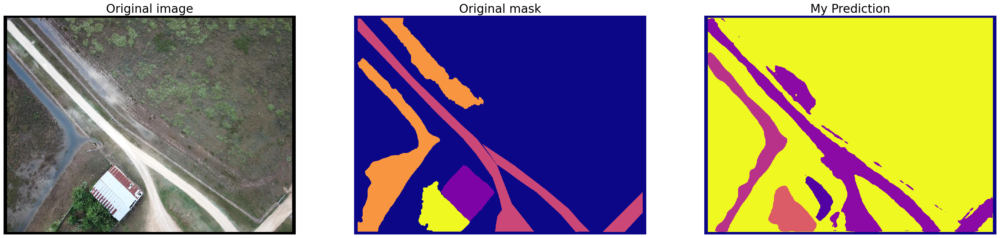

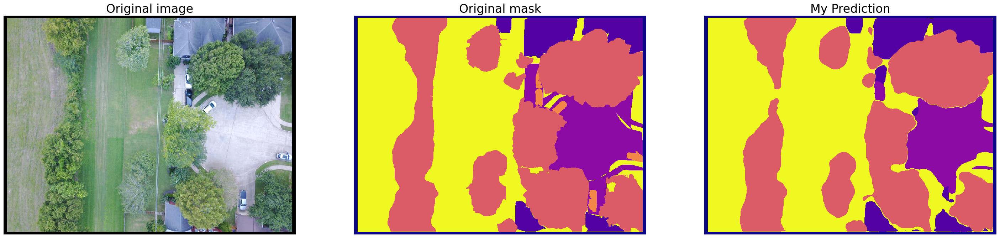

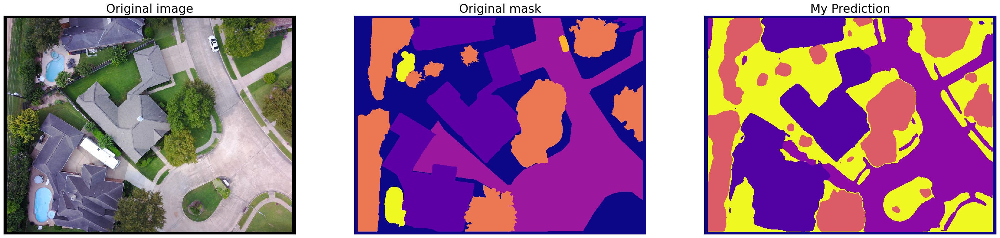

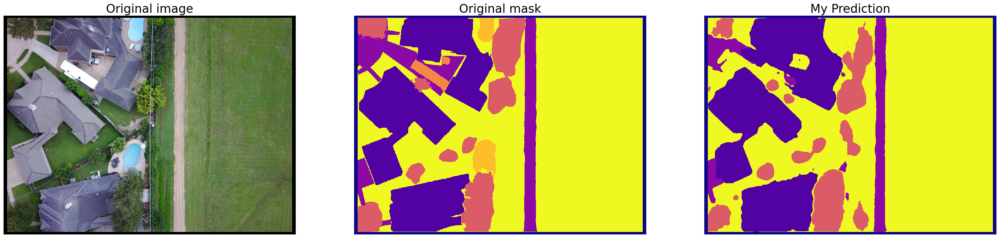

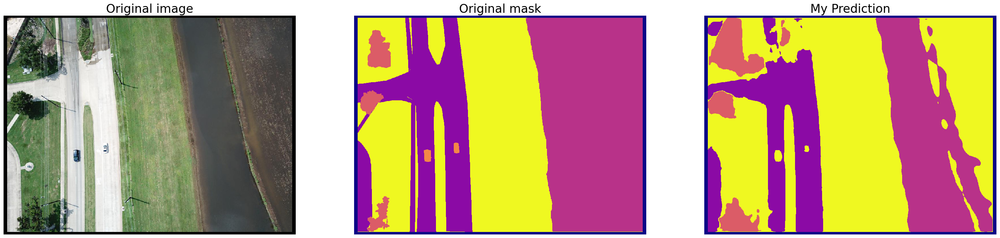

...

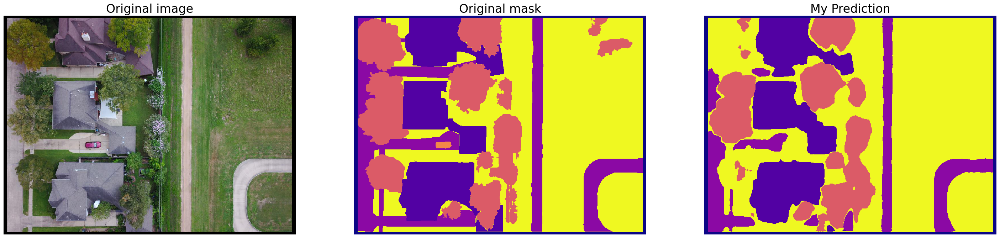

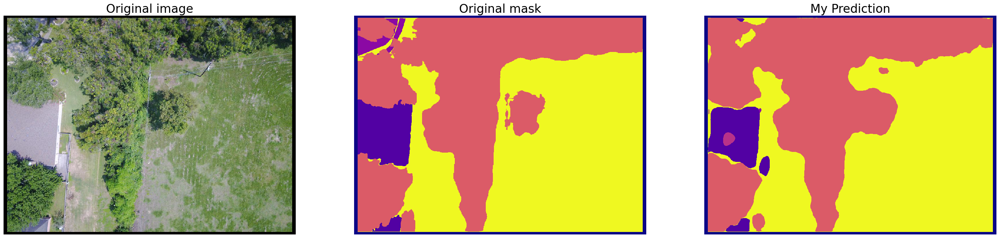

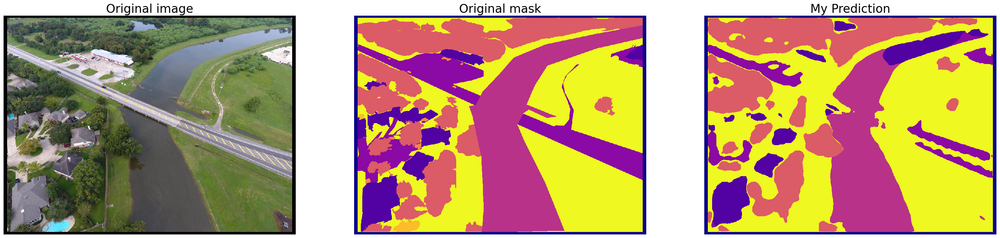

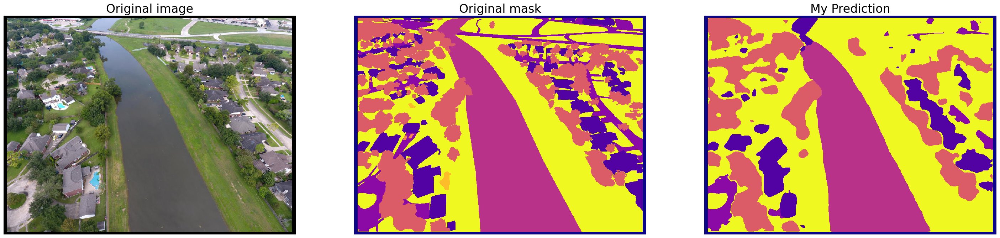

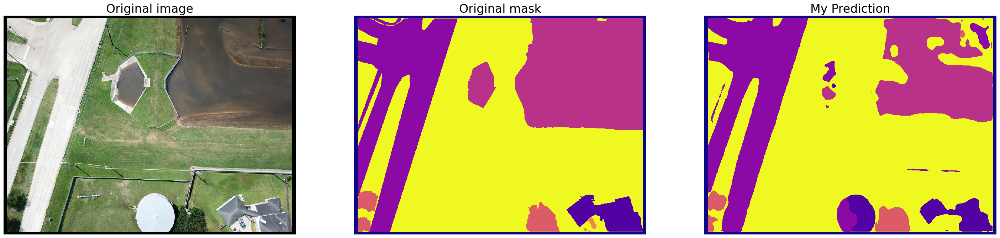

In [6]:
metrics = model.inference()

### Выводы: 
Бейзлайн надо было просто взять готовые веса сеток с этого соревнования и на этом можно было бы закончить.

Но я сделал следующие, я взял UNet с предобученным на ImageNet backbone с архитектурой ResNet152, в качестве оптимизатора был взят AdamW, а шедулер был StepLR, гиперпараметры указаны в py файле. Из аугментаций были флипы по двум осям, чтобы данных стало побольше, и padding, чтобы скормить это в сетку, также помогала техника рестартов. Также я решил не кропать картинки, а взять фуллсайз, размер батча у меня получился 6. В целом результаты приемлемые, хотя метрику mAcc я не понимаю, но она вышла 0.93, на мой взгляд она не информативна от слова совсем, т.к. даже пустая необученная сетка выдает 0.8 по этой метрике, т.к. достаточно того, чтобы ты предсказывал самый большой класс, который на картинке, и тогда по каждому маленькому классу мы получим большое значение, тогда в среднем выйдет что-то адекватное. В этом плане IoU или dice намного лучше. Например, в моей сетке, два класса очень плохо находятся, и $IoU = 0.58$ об этом явно говорит, а dice лучше, т.к. он напрямую связан с минимизируемой loss функцией, её я взял по каждому классу с разными весами, и ещё добавил туда кросс энтропияю, можно было бы ещё фокал, чтобы сконцентрироваться на плохих пикселях, или тверски (аналог дайса, но гиперпараметры, которого можно изменить, чтобы штрафовать меньше или больше за FP, FN), но у нас же учебная задача все таки. Также классы water и pool плохо различается, а оно и понятно, т.к. это вода и сетки тяжело, также ей тяжело распознавать машинки, т.к. они малы к общему размеры картинки, это можно было бы решить прокинув больший loss по этим классам.

Следующей итерацией была идея в том, чтобы заскейлить каналы из $[0, 255]$ в $[0, 1]$, добавили такую аугментацию, её надо добавлять и на train, и на test. Также хотелось бы отметить, что в ходе экспериментов было замечено интересное свойство для аффинных преобразований, а именно, что интерполяция в афинных преобразованиях (поворотах, zoom-ах, translat-ах, resha-ах) должна отличаться для картинки и для маски, если линейная и билинейная хорошо работают для картинок, то для маски плохо, т.к. внутри этих аугментаций есть округление, которое округляет следущим образом, что если получилось значение 0.9, то оно округлит до 0, а не до 1. Это приведено на примерах, которые Кирилл присылал в беседу, там как раз классы после ресайза отличаются от 1 вниз от тех, что должны быть, поэтому нужно использовать интеполяцию 'nearest'.

Чтобы решить проблему с тем, что бассейны и машины не находятся, был прокинуть фокал по всем классам, кроме background и добавлен Tversky loss с параметрами $alpha=0.1, beta=0.9$ и $\gamma=0.5$  для того, чтобы увеличить Recall по этим классам, но это ничего не дало. Результатов не дало, начну снова с претрейна на ImageNet.

Следующим экспериментом будет добавление Тверского с большим параметром $\alpha$, чтобы больше штрафовать другие классы за ложные прогнозы и не штрафовать машины и воду за это, и начну с претрейна ImageNet, т.к. сошлись в какой-то другой локальный минимум. Импакта не дало.

На этом, наверное, всё, учитывая проблемы в обучающей выборке, т.к. все таки соревнование было на 10 классов, а не на 8, например, вместо дороги, там вода отмечена. В целом наверное можно было обучить сетку отдельно детектить машинки и бассейны, либо накинуть костыли на постпроце, например, понятно, что если у меня выделяет желтым на дороге, то это машина, а не другой класс и менять на машину маску, но мне уже надоела эта домашка,  :)

In [5]:
import numpy as np
for key in metrics.keys():
    if key == 'loss' or key == 'entropy_loss' or key == 'dice_loss' or key == 'i_epoch':
        continue
    print(key, round(np.mean(metrics[key]), 4))

focal_loss 0.341
IoU 0.5879
Recall 0.6545
Accuracy 0.9373
IoU [background] 0.8224
IoU [Building] 0.6442
IoU [Road] 0.6091
IoU [Water] 0.6128
IoU [Tree] 0.7008
IoU [Vehicle] 0.0
IoU [Pool] 0.0
IoU [Grass] 0.7658
Recall [background] 0.8224
Recall [Building] 0.7362
Recall [Road] 0.6747
Recall [Water] 0.6533
Recall [Tree] 0.8288
Recall [Vehicle] 0.0
Recall [Pool] 0.0
Recall [Grass] 0.9161
Accuracy [background] 0.9228
Accuracy [Building] 0.9691
Accuracy [Road] 0.958
Accuracy [Water] 0.8841
Accuracy [Tree] 0.9549
Accuracy [Vehicle] 0.9941
Accuracy [Pool] 0.9911
Accuracy [Grass] 0.8794
